# Primer Analisis EDA y Filtrado de los Datos 

## Preparacion

In [1]:
# Importo librerías
import pandas as pd
import numpy as np
import psycopg2
import matplotlib.pyplot as plt
import seaborn as sns
import random
import matplotlib.image as mpimg

In [2]:
# Importo mis funciones personalizadas
import custom_functions as cf

## Conexion a la base de datos

In [3]:
# Obtengo las credenciales para la conexion.
import os
from dotenv import load_dotenv

load_dotenv() # Cargo las variables de entorno guardadas en el archivo .env.

db_username = os.getenv('DB_USERNAME')
db_password = os.getenv('DB_PASSWORD')
db_host = os.getenv('DB_HOST')
db_port = os.getenv('DB_PORT')
db_name = os.getenv('DB_NAME')

In [4]:
# Creo la conexión a la base de datos en PostgreSQL.
try:
    connection = psycopg2.connect(
        user=db_username,
        password=db_password,
        host=db_host,
        port=db_port,
        database=db_name
    )
    cursor = connection.cursor()
    print("¡Conexion exitosa a la base de datos!")
    print('')

    # Datos de la tabla 'jugadores'.
    query = "SELECT * FROM jugadores"
    data_jugadores = pd.read_sql(query, connection)
    print("Datos de la tabla 'jugadores':")
    print(data_jugadores.sample(7))
    print('')

     # Datos de la tabla 'partidos'.
    query = "SELECT * FROM partidos"
    data_partidos = pd.read_sql(query, connection)
    print("Datos de la tabla 'partidos':")
    print(data_partidos.sample(7))
    print('')

     # Datos de la tabla 'goles'.
    query = "SELECT * FROM goles"
    data_goles = pd.read_sql(query, connection)
    print("Datos de la tabla 'goles':")
    print(data_goles.sample(7))
    print('')

    
     # Datos de la tabla 'posiciones'.
    query = "SELECT * FROM posiciones"
    data_posiciones = pd.read_sql(query, connection)
    print("Datos de la tabla 'posiciones':")
    print(data_posiciones.sample(7))
    print('')

except Exception as error:
    print("Error al conectar a la base de datos:", error)

finally:
    if connection:
        cursor.close()
        connection.close()
        print("¡Conexion cerrada!")

¡Conexion exitosa a la base de datos!



C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\988966875.py:16: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_jugadores = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\988966875.py:23: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_partidos = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\988966875.py:30: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  data_goles = pd.read_sql(query, connection)
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_177

Datos de la tabla 'jugadores':
     player_id    player_name
32          32         Eze💥⚡️
382        382        puerron
92          92         Tobias
139        139            jax
386        386           Enzo
270        270    𝕊𝕄𝕊 ʰᵃˣᵇᵃˡˡ
269        269          nixx!

Datos de la tabla 'partidos':
     match_id              start_time                end_time
39         40 2025-01-09 05:14:21.550 2025-01-09 05:15:22.732
311       312 2025-01-29 01:24:28.654 2025-01-29 01:27:55.406
129       130 2025-01-16 06:06:40.579 2025-01-16 06:09:43.641
248       249 2025-01-28 03:19:36.408 2025-01-28 03:21:42.685
297       298 2025-01-29 00:56:41.428 2025-01-29 00:59:01.717
38         39 2025-01-09 05:12:51.096 2025-01-09 05:14:20.831
130       131 2025-01-16 06:09:48.774 2025-01-16 06:11:04.620

Datos de la tabla 'goles':
      id  match_id  player_id  player_name equipo       tick
28    97        14          9  Ramiis 𝓒𝓐𝓡𝓟    Red        NaN
486  555       209        184        Mænu     Red  5

In [5]:
# Guardo los datos crudos en la carpeta '/raw_data'
ruta_archivo = os.path.join('./raw_data', 'data_jugadores.csv')
data_jugadores.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_partidos.csv')
data_partidos.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_posiciones.csv')
data_posiciones.to_csv(ruta_archivo, index=False)

ruta_archivo = os.path.join('./raw_data', 'data_goles.csv')
data_goles.to_csv(ruta_archivo, index=False)

## Analisis exploratorio
Exploro los datos de las tablas.

### Imagen de la cancha para plotear

In [6]:
background_image = mpimg.imread('stadium.PNG')

### Conteos de valores

In [7]:
# Analizo la cantidad de repeticiones de valores en las columnas seleccionadas en las tablas seleccionadas.
columns_goles = ['match_id', 'player_name', 'equipo']
columns_posiciones = ['match_id', 'player_id']

cf.print_value_counts(data_goles, 'data_goles', 5, columns_goles)
cf.print_value_counts(data_posiciones, 'data_posiciones', 5, columns_posiciones)

Value counts para data_goles - Columna: match_id
match_id
63     6
104    5
318    5
237    5
240    5
Name: count, dtype: int64


Value counts para data_goles - Columna: player_name
player_name
tnt                   138
Tuc                    22
marco!"                20
!    𝕒𝕣𝕚𝕤𝕥𝕠 ¿?         15
SAMIR-ESKIMAL          14
Name: count, dtype: int64


Value counts para data_goles - Columna: equipo
equipo
Red     536
Blue    500
Name: count, dtype: int64


Value counts para data_posiciones - Columna: match_id
match_id
25     2409
262    2324
422    2009
76     1946
398    1946
Name: count, dtype: int64


Value counts para data_posiciones - Columna: player_id
player_id
0      45645
2      25015
325     3961
48      3618
120     3539
Name: count, dtype: int64




In [8]:
# Agrupo por match_id y tick, y cuento la cantidad de aparariciones de cada grupo.
# Esto vendria a contar la cantidad de entidades 'entities' en el momento 'match_id - time'.
data_grouped_entities = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='entities')

print("DataFrame con el conteo de grupos:")
print('')
data_grouped_entities.sample(10)

DataFrame con el conteo de grupos:



,match_id,time,entities
42352,421,53.416667,7
43661,433,74.350000,7
1040,14,76.016667,7
12855,129,172.000000,7
6343,71,72.600000,7
10354,104,144.616667,7
27097,282,1.850000,7
32050,325,76.983333,7
19327,210,20.900000,7
38028,389,37.766667,7


In [9]:
# Observo la cantidad de momentos en los que hubo cierta cantidad de entidades (lo ideal es 7: 3 reds, 3 blues, 1 ball). 
columns_grouped_entities = ['time', 'entities']
cf.print_value_counts(data_grouped_entities, 'data_grouped_entities' , 20, columns_grouped_entities)

Value counts para data_grouped_entities - Columna: time
time
0.000000      162
180.000000     62
0.983333       34
1.983333       33
2.983333       29
3.983333       27
4.983333       25
5.983333       23
6.983333       23
7.983333       23
8.983333       23
9.983333       21
10.983333      21
11.983333      21
13.983333      20
12.983333      20
14.983333      19
15.983333      18
16.983333      17
17.983333      17
Name: count, dtype: int64


Value counts para data_grouped_entities - Columna: entities
entities
7     38135
3      2679
5      1634
6      1505
2       351
4       324
28       52
35       46
21       38
42       13
14        8
8         7
15        6
49        6
10        4
20        4
18        3
24        3
31        2
27        2
Name: count, dtype: int64




### Partidos en los que siempre hubieron 7 entidades en la cancha
Estos son, probablemente, los partidos mas relevantes a anaizar y los mas útiles para entrenar al modelo, aunque no serán los únicos.

In [10]:
# Contar las ocurrencias por match_id y time
counts_per_time = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='count')

# Filtrar match_ids donde siempre hay 7 entidades en cada momento
matches_with_always_7ents = counts_per_time[counts_per_time['count'] == 7]['match_id'].unique()

# Verificar si un match_id tiene menos de 7 en algún momento
always_7ents_match_ids = [
    match_id for match_id in matches_with_always_7ents
    if counts_per_time[counts_per_time['match_id'] == match_id]['count'].nunique() == 1
]

always_7ents_match_ids

[17,
 20,
 23,
 24,
 29,
 30,
 31,
 32,
 42,
 43,
 46,
 51,
 52,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 64,
 68,
 69,
 70,
 71,
 72,
 73,
 77,
 78,
 79,
 90,
 99,
 102,
 103,
 104,
 109,
 111,
 116,
 117,
 123,
 127,
 128,
 135,
 136,
 137,
 142,
 144,
 145,
 170,
 192,
 195,
 196,
 197,
 203,
 204,
 205,
 206,
 210,
 211,
 220,
 222,
 223,
 224,
 240,
 244,
 245,
 246,
 247,
 248,
 249,
 250,
 251,
 252,
 254,
 267,
 275,
 276,
 277,
 282,
 287,
 288,
 289,
 290,
 292,
 295,
 308,
 309,
 310,
 313,
 319,
 320,
 321,
 325,
 326,
 327,
 328,
 349,
 350,
 357,
 373,
 374,
 379,
 380,
 381,
 390,
 393,
 398,
 400,
 404,
 406,
 410,
 411,
 414,
 417,
 418,
 419,
 420,
 421,
 422,
 433,
 441]

### Agrupo datos para EDA

In [11]:
# Agrupo momentos con sus entidades
time_counts = data_grouped_entities['time'].value_counts().sort_index()
data_time_counts = time_counts.reset_index()
data_time_counts.columns = ['time', 'count']

# Agrupo momentos con sus entidades y filtro los momentos que tengan exactamente 7 entidades
data_grouped_entities_7ents = data_grouped_entities[data_grouped_entities['entities'] == 7]
time_counts_7ents = data_grouped_entities_7ents['time'].value_counts().sort_index()
data_time_counts_7ents = time_counts_7ents.reset_index()
data_time_counts_7ents.columns = ['time', 'count']

### Cantidad de partidos por cantidad de goles y resultados

C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\3131938590.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=goal_counts, x='total_goals', palette='Greens')


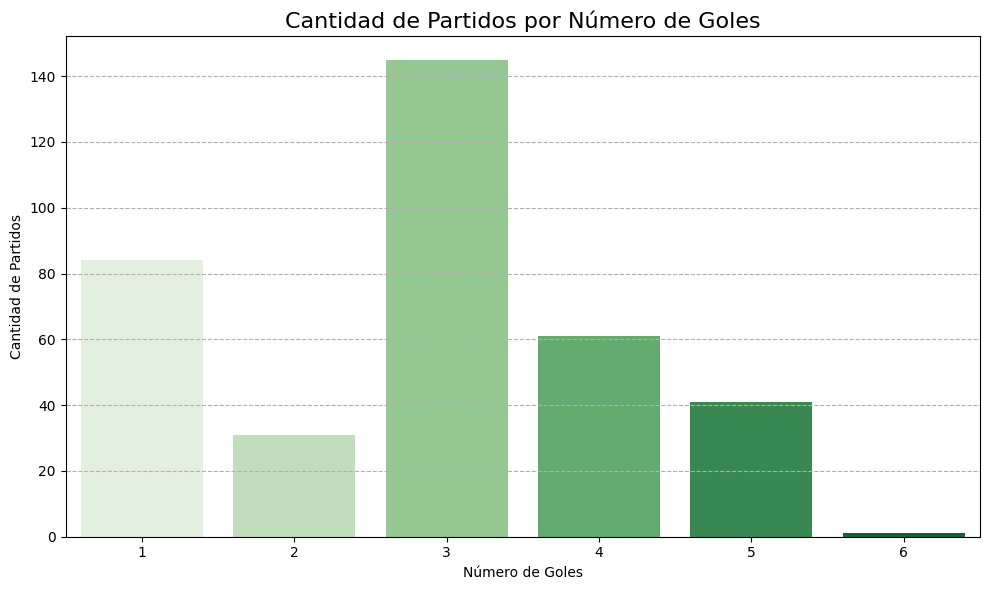

In [12]:
# Obtener la cantidad de goles por partido
goal_counts = data_goles.groupby('match_id').size().reset_index(name='total_goals')

# Crear barplot de la distribución de goles por partido
plt.figure(figsize=(10, 6))
sns.countplot(data=goal_counts, x='total_goals', palette='Greens')
plt.title('Cantidad de Partidos por Número de Goles', fontsize=16)
plt.xlabel('Número de Goles')
plt.ylabel('Cantidad de Partidos')
plt.xticks()
plt.grid(axis='y', linestyle='--')
plt.tight_layout()
plt.show()

In [13]:
# Filtrar partidos con el máximo time entre 179 y 180
matches_grouped = data_posiciones.groupby('match_id')['time'].max().reset_index()
matches_that_finished_by_time_limit = matches_grouped[(matches_grouped['time'] >= 179) & (matches_grouped['time'] <= 180)]

# Filtrar partidos con el máximo time menor a 179 y un ganador con 3 goles o más
matches_that_finished_by_red_or_blue_win = matches_grouped[matches_grouped['time'] < 179]
match_results = data_goles.groupby(['match_id', 'equipo']).size().unstack(fill_value=0).reset_index()
match_results.columns = ['match_id', 'Blue', 'Red']

# Filtrar para los partidos donde el ganador tiene 3 goles o más
match_results['Red'] = match_results['Red'].astype(int)
match_results['Blue'] = match_results['Blue'].astype(int)

match_results_filtered = match_results[(match_results['Red'] >= 3) | (match_results['Blue'] >= 3)]
matches_that_finished_by_red_or_blue_win = matches_that_finished_by_red_or_blue_win[matches_that_finished_by_red_or_blue_win['match_id'].isin(match_results_filtered['match_id'])]

# Filtrar partidos con el máximo time mayor a 180 y con un ganador
matches_that_finished_after_180 = matches_grouped[matches_grouped['time'] > 180]
matches_that_finished_after_180 = matches_that_finished_after_180[matches_that_finished_after_180['match_id'].isin(match_results['match_id'])]

# Concatenar todos los partidos válidos
valid_matches = pd.concat([
    matches_that_finished_by_time_limit,
    matches_that_finished_by_red_or_blue_win,
    matches_that_finished_after_180
])

# Combinar con los resultados de goles
valid_matches_with_results = match_results.merge(valid_matches, on='match_id')

# Añadir la columna de resultado como texto
valid_matches_with_results['Resultado'] = valid_matches_with_results.apply(
    lambda row: f"{int(row['Red'])}-{int(row['Blue'])}", axis=1
)

# Añadir la columna de "Modo de victoria" para indicar cómo terminó cada partido
valid_matches_with_results['Modo_Victoria'] = valid_matches_with_results['time'].apply(
    lambda x: 'Antes del 180' if x < 179 else ('En el 180' if 179 <= x <= 181 else 'Después del 180')
)

# Filtrar los partidos con resultados relevantes
valid_matches_with_results_filtered = valid_matches_with_results[
    (valid_matches_with_results['Red'] != valid_matches_with_results['Blue']) | 
    (valid_matches_with_results['Red'] >= 3) | 
    (valid_matches_with_results['Blue'] >= 3)
]

# Mostrar el DataFrame resultante
print(valid_matches_with_results_filtered)

     match_id  Blue  Red        time Resultado    Modo_Victoria
0           3     3    0   99.716667       0-3    Antes del 180
1           4     3    1  109.983333       1-3    Antes del 180
2           7     3    0   76.350000       0-3    Antes del 180
3          12     2    1  180.000000       1-2        En el 180
4          13     3    2  149.650000       2-3    Antes del 180
..        ...   ...  ...         ...       ...              ...
275       436     0    1  180.000000       1-0        En el 180
276       437     1    2  180.000000       2-1        En el 180
277       438     0    3   87.200000       3-0    Antes del 180
278       440     3    2  193.816667       2-3  Después del 180
279       441     3    0   63.566667       0-3    Antes del 180

[280 rows x 6 columns]


In [14]:
valid_matches_with_results_filtered['Modo_Victoria'].value_counts()

Modo_Victoria
Antes del 180      180
En el 180           63
Después del 180     37
Name: count, dtype: int64

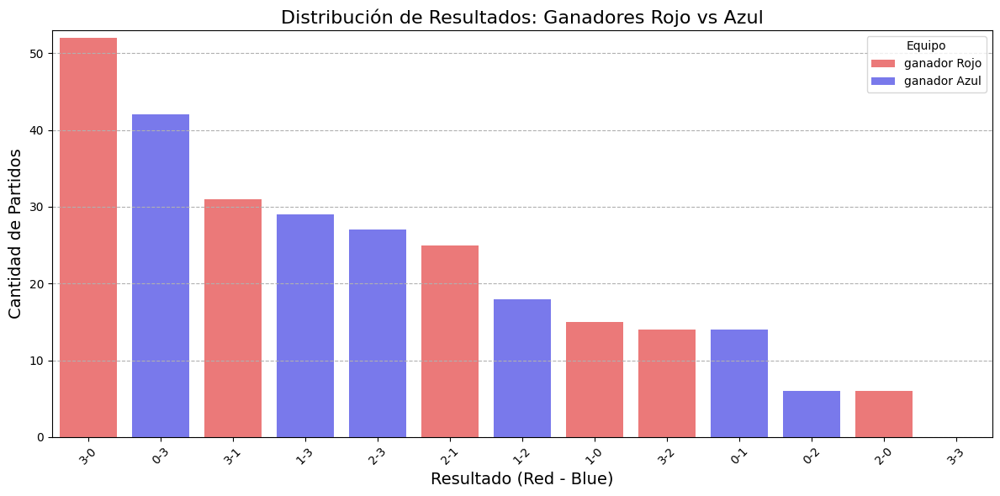

In [15]:
# Dividir los datos para los partidos ganados por el equipo rojo y azul
matches_red_wins  = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Red'] > valid_matches_with_results_filtered['Blue']]
matches_blue_wins = valid_matches_with_results_filtered[valid_matches_with_results_filtered['Blue'] > valid_matches_with_results_filtered['Red']]

# Encontrar el máximo conteo de los resultados para ajustar los límites del gráfico
max_red_wins_count = matches_red_wins['Resultado'].value_counts().max()
max_blue_wins_count = matches_blue_wins['Resultado'].value_counts().max()
max_count = max(max_red_wins_count, max_blue_wins_count)

# Crear el gráfico en una sola figura
plt.figure(figsize=(12, 6))

# Barplot para el equipo rojo
sns.countplot(data=matches_red_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='red', label='Rojo', alpha=0.6)

# Barplot para el equipo azul, superpuesto al gráfico rojo
sns.countplot(data=matches_blue_wins, x='Resultado', order=valid_matches_with_results_filtered['Resultado'].value_counts().index, color='blue', label='Azul', alpha=0.6)

# Ajustes de título, etiquetas y leyenda
plt.title('Distribución de Resultados: Ganadores Rojo vs Azul', fontsize=16)
plt.xlabel('Resultado (Red - Blue)', fontsize=14)
plt.ylabel('Cantidad de Partidos', fontsize=14)
plt.ylim(0, max_count + 1)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--')

# Mostrar leyenda
plt.legend(title='Equipo', labels=['ganador Rojo', 'ganador Azul'], loc='upper right')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Distribucion de los ticks en los momentos captados en los partidos

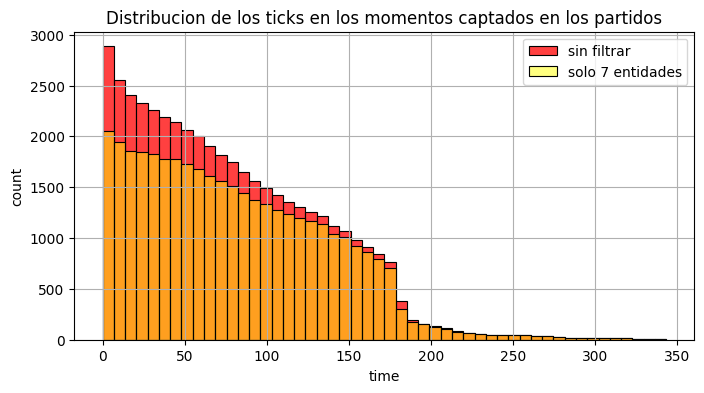

In [16]:
# Histograma de la distribucion de los ticks en los momentos captados en los partidos
plt.figure(figsize=(8, 4))

h1 = sns.histplot(data_time_counts, x='time', weights='count', color='red', kde=False, bins=50, label='sin filtrar')
h2 = sns.histplot(data_time_counts_7ents, x='time', weights='count', color='yellow', alpha=0.5, kde=False, bins=50, label='solo 7 entidades')

plt.title('Distribucion de los ticks en los momentos captados en los partidos')
plt.xlabel('time')
plt.ylabel('count')

handles, labels = plt.gca().get_legend_handles_labels()
plt.legend(handles, labels, loc='upper right')

plt.grid(True)

plt.show()

El histograma muestra la distribución de los ticks de los momentos de los partidos que fueron recoilados. En rojo grafico se muestran todos, en amarillo a los pertenecientes a momentos con 7 entidades exactamente en la cancha, y en naranja cuando ambas barras se solapan (es de esperar que no se vea amarillo, y solo naranja).

Notar que la duración estándar de un partido es de 300 ticks, pero puede terminar antes si un equipo mete 3 goles, o puede terminar despues si en el tick 300 el partido va empatado.



### Distribucion de goles a lo largo de los ticks

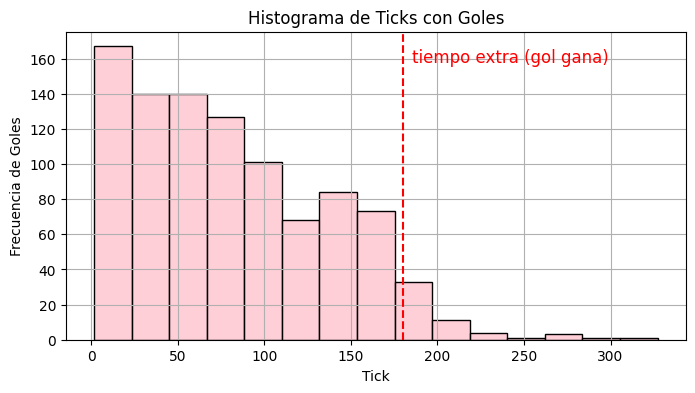

In [17]:
plt.figure(figsize=(8,4))

# Crear el histograma
sns.histplot(data=data_goles, x='tick', bins=15, kde=False, color='pink')

# Añadir una línea punteada en el valor 180 del eje x
plt.axvline(x=180, color='red', linestyle='--')

# Añadir un texto a la derecha de la línea
plt.text(185, plt.gca().get_ylim()[1] * 0.9, 'tiempo extra (gol gana)', color='red', fontsize=12)

# Configurar el título y las etiquetas de los ejes
plt.title('Histograma de Ticks con Goles')
plt.xlabel('Tick')
plt.ylabel('Frecuencia de Goles')
plt.grid(True)

# Mostrar el gráfico
plt.show()

### Momentos de partidos

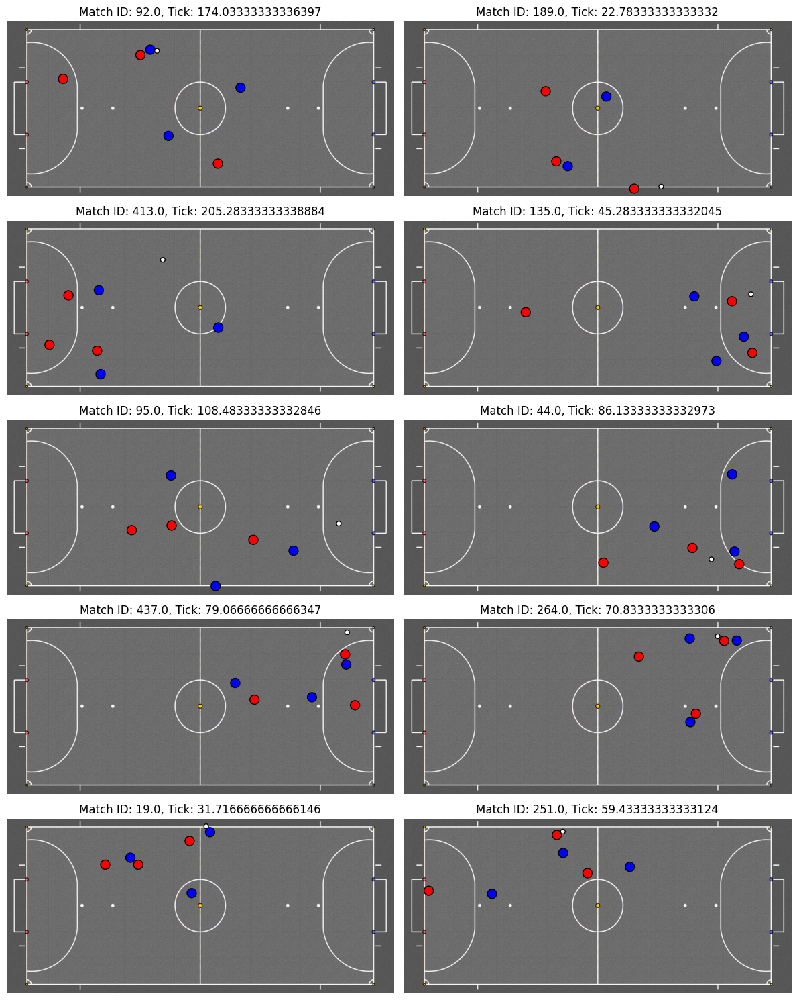

In [18]:
# Plots de momentos de partidos al azar

# Seleccionar aleatoriamente combinaciones de match_id y tick
unique_moments = data_posiciones[['match_id', 'time']].drop_duplicates()
random_moments = unique_moments.sample(n=10)

# Crear subplots
fig, axs = plt.subplots(5, 2, figsize=(12, 15))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Filtrar y graficar los datos para cada momento seleccionado
for i, (index, moment) in enumerate(random_moments.iterrows()):
    match_id = moment['match_id']
    tick = moment['time']
    
    # Filtrar datos para el momento actual
    moment_data = data_posiciones[(data_posiciones['match_id'] == match_id) & (data_posiciones['time'] == tick)]
    
    # Graficar los datos en el subplot correspondiente
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')
    
    # Asignar colores y tamaños según el equipo
    colors = moment_data['team'].map({'0': 'white', '1': 'red', '2': 'blue'})
    sizes = moment_data['team'].map({'0': 25, '1': 100, '2': 100})
    
    scatter = ax.scatter(moment_data['x'], moment_data['y'], c=colors, s=sizes, edgecolors='black')
    ax.set_title(f'Match ID: {match_id}, Tick: {tick}')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes

plt.tight_layout()
plt.show()

match_id seleccionado: 54
Cantidad de ticks (momentos) captados: 80


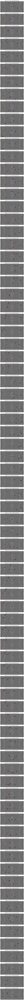

In [19]:
# Ploteo un partido entero, momento por momento
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Seleccionar un match_id al azar
random_match_id = 54 #data_posiciones['match_id'].sample(1).iloc[0]
print('match_id seleccionado:', random_match_id)

# Filtrar todos los momentos de ese partido
match_data = data_posiciones[data_posiciones['match_id'] == random_match_id].sort_values('time')

# Extraer los ticks únicos
ticks = match_data['time'].unique()
print('Cantidad de ticks (momentos) captados:',len(ticks))

fig, axs = plt.subplots(len(ticks), 1, figsize=(6, len(ticks) * 3))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Cargar la imagen de fondo de la cancha de fútbol
background_image = mpimg.imread('C:/Users/ASROCK/Desktop/haxball_ai/maps/x3_bazinga.PNG')

# Iterar sobre cada tick y mostrar el gráfico correspondiente
for i, frame in enumerate(ticks):
    # Filtrar datos para el momento actual
    moment_data = match_data[match_data['time'] == frame]
    
    # Graficar los datos en el subplot correspondiente
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')
    
    # Asignar colores y tamaños según el equipo
    colors = moment_data['team'].map({'0': 'white', '1': 'red', '2': 'blue'})
    sizes = moment_data['team'].map({'0': 25, '1': 100, '2': 100})
    
    scatter = ax.scatter(moment_data['x'], moment_data['y'], c=colors, s=sizes, edgecolors='black')
    ax.set_title(f'Match ID: {random_match_id}, Tick: {frame}')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes
    
# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Etiquetando algunos datos

In [20]:
# Crear nuevas columnas en nuevo dataframe de etiquetado, inicializadas con 'none' para indicar si habrá gol en los próximos 'n' ticks

data_grouped_entities_7ents_labeled = data_grouped_entities_7ents
data_grouped_entities_7ents_labeled['gol_1_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_2_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_3_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_4_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_5_ticks'] = 'none'
data_grouped_entities_7ents_labeled['gol_6_ticks'] = 'none'

# Crear un diccionario para acceso rápido a los goles por match_id
goles_dict = data_goles.groupby('match_id').apply(lambda x: x[['tick', 'equipo']].to_dict('records')).to_dict()

C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\2042237518.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_grouped_entities_7ents_labeled['gol_1_ticks'] = 'none'
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\2042237518.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_grouped_entities_7ents_labeled['gol_2_ticks'] = 'none'
C:\Users\ASROCK\AppData\Local\Temp\ipykernel_17720\2042237518.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try 

In [21]:
# Iterar sobre las filas de data_grouped_entities_7ents
for index, row in data_grouped_entities_7ents.iterrows():
    match_id = row['match_id']
    time = row['time']
    
    if match_id in goles_dict:
        goles = goles_dict[match_id]
        
        # Filtrar goles futuros a partir del tiempo actual
        futuros_goles = [gol for gol in goles if gol['tick'] > time]
        
        for offset in range(1, 7):  # Revisar para ticks 1, 2, 3, 4, 5 y 6
            gol_cercano = next((gol['equipo'] for gol in futuros_goles if gol['tick'] <= time + offset), 'none')
            col_name = f'gol_{offset}_ticks'
            data_grouped_entities_7ents.at[index, col_name] = gol_cercano


In [22]:
# Verificar resultados solo para match_id elegido
match_id_test = 54
data_grouped_entities_7ents_match_id_test = data_grouped_entities_7ents[data_grouped_entities_7ents['match_id'] == match_id_test]

# Configurar para mostrar todas las filas y columnas
pd.set_option('display.max_rows', None)  # Muestra todas las filas
pd.set_option('display.max_columns', None)  # Muestra todas las columnas
pd.set_option('display.expand_frame_repr', False)  # Evita que las columnas se corten

# Muestra una muestra aleatoria o todas las filas del match_id 54
data_grouped_entities_7ents_match_id_test

,match_id,time,entities,gol_1_ticks,gol_2_ticks,gol_3_ticks,gol_4_ticks,gol_5_ticks,gol_6_ticks
4562,54,0.633333,7,none,none,none,none,none,none
4563,54,1.633333,7,none,none,none,none,none,none
4564,54,2.633333,7,none,none,none,none,none,none
4565,54,3.633333,7,none,none,none,none,none,none
4566,54,4.633333,7,none,none,none,none,none,none
4567,54,5.633333,7,none,none,none,none,none,none
4568,54,6.633333,7,none,none,none,none,none,none
4569,54,7.633333,7,none,none,none,none,none,Blue
4570,54,8.633333,7,none,none,none,none,Blue,Blue
4571,54,9.633333,7,none,none,none,Blue,Blue,Blue


In [23]:
# Configurar para volver a los valores estandar de las filas y columnas
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.expand_frame_repr')

### Posicionamiento en la cancha de todos los jugadores en un partido

match_id seleccionado: 311
Resultado del partido: Equipo Red 2 - 0 Equipo Blue


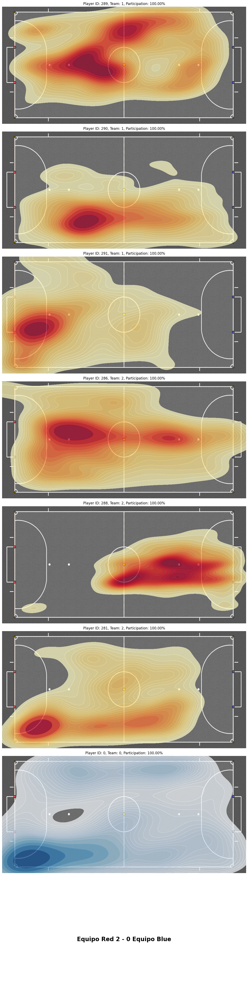

In [24]:
# Mapa de calor de todos los jugadores en un partido
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg

# Proporcionar el match_id deseado
match_id = 311  # Cambia esto al match_id deseado
print('match_id seleccionado:', match_id)

# Contar los goles de cada equipo en el partido
goles_red = data_goles[(data_goles['match_id'] == match_id) & (data_goles['equipo'] == 'Red')].shape[0]
goles_blue = data_goles[(data_goles['match_id'] == match_id) & (data_goles['equipo'] == 'Blue')].shape[0]
resultado_partido = f'Equipo Red {goles_red} - {goles_blue} Equipo Blue'
print('Resultado del partido:', resultado_partido)

# Filtrar todos los momentos de ese partido
match_data = data_posiciones[data_posiciones['match_id'] == match_id]

# Obtener las combinaciones únicas de jugador y equipo en el partido
unique_combinations = match_data[['player_id', 'team']].drop_duplicates()

# Crear subplots
fig, axs = plt.subplots(len(unique_combinations) + 1, 1, figsize=(12, (len(unique_combinations) + 1) * 6))
axs = axs.ravel()  # Aplanar el array de ejes para facilitar el acceso

# Cargar la imagen de fondo de la cancha de fútbol
background_image = mpimg.imread('C:/Users/ASROCK/Desktop/haxball_ai/maps/x3_bazinga.PNG')

# Calcular el número total de momentos en el partido
total_moments = match_data['time'].nunique()

# Iterar sobre cada combinación jugador-equipo y crear su mapa de calor
for i, (index, row) in enumerate(unique_combinations.iterrows()):
    player_id = row['player_id']
    team = row['team']
    
    # Filtrar datos para el jugador y equipo actual
    player_team_data = match_data[(match_data['player_id'] == player_id) & (match_data['team'] == team)]
    
    # Calcular el porcentaje de momentos en los que el jugador estuvo presente
    player_moments = player_team_data['time'].nunique()
    participation_percentage = (player_moments / total_moments) * 100
    
    # Graficar la imagen de fondo
    ax = axs[i]
    ax.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

    # Gradiente de colores dependiendo de si es jugador o pelota
    if(player_id == 0):
        gradiente_de_colores = 'Blues'
    else:
        gradiente_de_colores = 'YlOrRd'

    
    # Crear el mapa de calor con la nueva paleta de colores y umbral ajustado
    sns.kdeplot(
        x=player_team_data['x'], y=player_team_data['y'], 
        fill=True, cmap=gradiente_de_colores, ax=ax, 
        bw_adjust=0.75, levels=20, thresh=0.1, alpha=0.7 # Umbral ajustado
    )
    
    ax.set_title(f'Player ID: {player_id}, Team: {team}, Participation: {participation_percentage:.2f}%')
    ax.set_xlim([-605, 605])
    ax.set_ylim([-255, 255])
    ax.axis('off')  # Opcional: para ocultar los ejes

# Añadir el resultado del partido en el último subplot
ax = axs[-1]
ax.text(0.5, 0.5, resultado_partido, horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, fontsize=20, weight='bold')
ax.axis('off')  # Ocultar los ejes

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Distribución de la pelota en todos los partidos de la base de datos

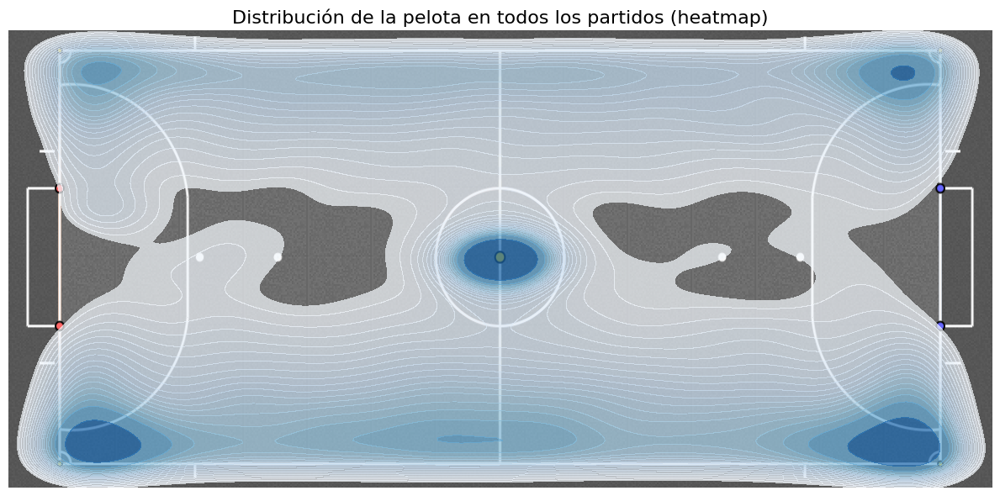

In [25]:
# Mapa de calor de la pelota en todos los partidos de la base de datos
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Filtrar solo las posiciones de la pelota
ball_data = data_posiciones[data_posiciones['player_id'] == 0]

# Crear el gráfico
plt.figure(figsize=(12, 6))
plt.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

# Crear el mapa de calor para las posiciones de la pelota
sns.kdeplot(
    x=ball_data['x'], y=ball_data['y'], 
    fill=True, cmap='Blues', bw_adjust=0.75, levels=20, thresh=0.1, alpha=0.7
)

# Configurar límites y ocultar ejes
plt.xlim([-605, 605])
plt.ylim([-255, 255])
plt.axis('off')  # Ocultar ejes

# Título
plt.title('Distribución de la pelota en todos los partidos (heatmap)', fontsize=16)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

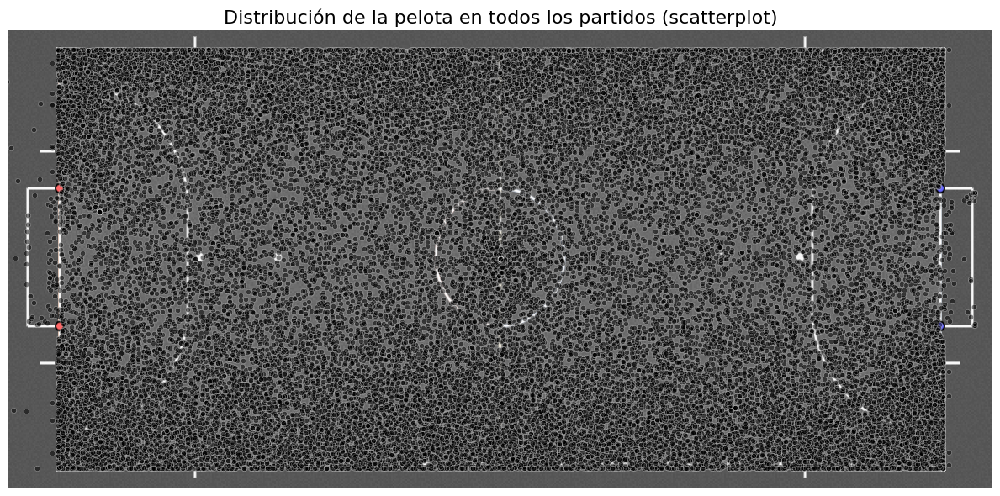

In [26]:
plt.figure(figsize=(12, 6))
plt.imshow(background_image, extent=[-605, 605, -255, 255], aspect='auto')

sns.scatterplot(
    x=ball_data['x'], y=ball_data['y'],
    color='Black', edgecolor='White', s=20, alpha=0.5
)

plt.xlim([-605, 605])
plt.ylim([-255, 255])
plt.axis('off')  # Ocultar ejes

plt.title('Distribución de la pelota en todos los partidos (scatterplot)', fontsize=16)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

### Posicionamiento de la pelota antes de un gol en menos de n ticks, para cada equipo

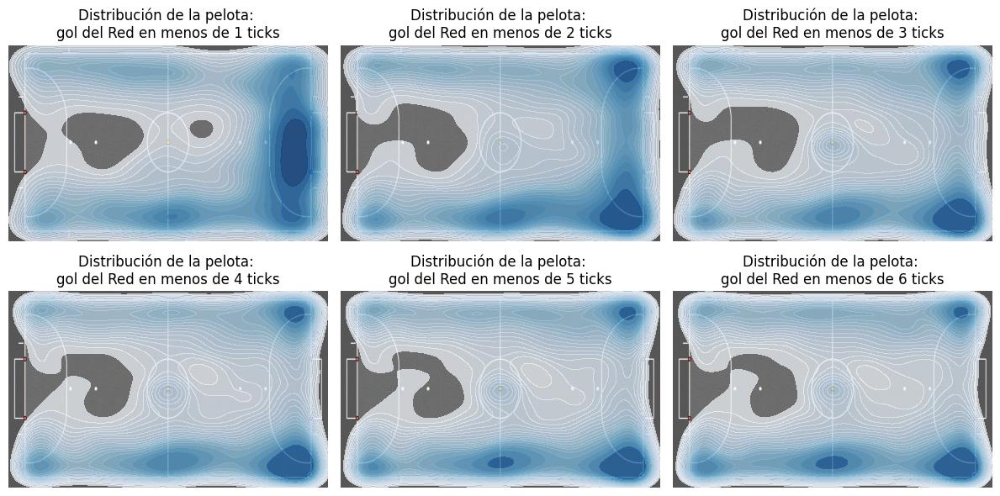

In [27]:
cf.plot_ball_heatmaps_for_team_goal(equipo='Red', title_prefix='Distribución de la pelota: ', data_pos=data_posiciones, data_grouped=data_grouped_entities_7ents)

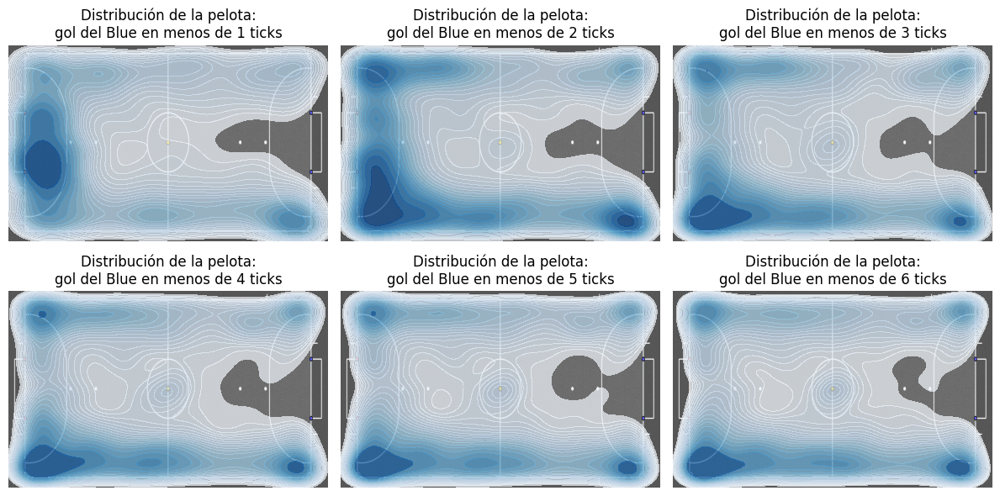

In [28]:
cf.plot_ball_heatmaps_for_team_goal(equipo='Blue', title_prefix='Distribución de la pelota:', data_pos=data_posiciones, data_grouped=data_grouped_entities_7ents)

## Filtrado de datos
Filtro datos que no me interesa tener en cuenta. A continuacion se enumeran, y se muestran algunas listas de ids o dataframes relevantes en cada caso:
* ids partidos que cumplen con el criterio del 90%: ids_90_percent_true
* ids de momentos no repetidos: ids_not_in_kickoff
* ids de momentos en los que no se está en kickoff: ids_not_in_kickoff_nor_cero
* ids de partidos con desorden en los registros de momentos: ids_out_of_order_matches
* ids de partidos con desorden en los registros de goles: ids_out_of_order_goals_matches
* ids de momentos en los que habian 7 entidades en cancha: ids_filtered_7ents_moments
* ids de partidos que sobrevivieron el filtrado (por lo menos con un momento del partido): ids_filtered

En la siguiente tabla se coloca informacion relevante sobre cada filtro, y se la analiza al finalizar el filtrado.

In [29]:
tabla_de_filtros = {
    'filtro': ['ninguno'],
    'cant_de_momentos': [data_posiciones.shape[0]],
    '%_respecto_a_original': [100],
    '%_respecto_a_anterior': [100]
}
data_filtros = pd.DataFrame(tabla_de_filtros)
previous_shape = data_posiciones.shape # Variable para futuros analisis de resultados de filtrados

#### Obtengo ids de partidos que cumplen con el criterio del 90%
* Un partido cumple con el criterio del 90% si en dicho porcentaje de los momentos (ticks) de los que se tienen registro del partido tienen exactamente 7 entidades en el campo de juego.
* Este criterio fue creado con el fin de obtener los ids de los partidos en los que la mayoria del tiempo se jugo en igualdad de condiciones, y los equipo no estuvieron en desventaja. Seran estos los partidos que serviran de base para el filtrado, pues son los que probablemente se hayan desarrollado en las mejores condiciones de igualdad y competencia.
* El criterio no tiene en cuenta jugadores afk, que hacen presencia pero no estan moviendose. Sin embargo, como me importan las posiciones y velocidades, he decidido ignorar de momento esta condicion.
* Ademas, se da por centado que al haber 7 entidades en la cancha, una es la pelopta y las otras 6 se reparten en partes iguales por equipo. Sin enbargo esto podria no ser verdad, y que haya por ejemplo 4 del Red y 2 del Blue. Se decide confiar en el manejo de los admins de turno.

In [30]:
# Vuelvo a crear y utilizar data_grouped_entities
data_grouped_entities = data_posiciones.groupby(['match_id', 'time']).size().reset_index(name='entities')
data_grouped_entities['match_id'].unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,
        28,  29,  30,  31,  32,  33,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  66,  67,  68,
        69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,
        82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,  94,
        95,  96,  97,  98,  99, 100, 101, 102, 103, 104, 105, 106, 107,
       108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120,
       121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133,
       134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146,
       149, 150, 153, 154, 155, 156, 158, 160, 161, 162, 163, 164, 165,
       166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178,
       180, 181, 182, 183, 184, 185, 187, 188, 189, 190, 191, 19

In [31]:
# Calculo para cada partido si se cumple con el criterio del 90%
partidos_90_percent_criteria = data_grouped_entities.loc[:, ['match_id']].drop_duplicates(subset=['match_id'])
partidos_90_percent_criteria['90%_criteria'] = np.nan

ids = data_grouped_entities['match_id'].unique()

for id_ in ids:
    data_from_matchid = data_grouped_entities[data_grouped_entities['match_id'] == id_]
    ents_7 =  data_from_matchid[data_from_matchid['entities'] == 7].shape[0]
    ents_nan =  data_from_matchid[pd.notna(data_from_matchid['entities'])].shape[0]
    total = data_from_matchid.shape[0]

    if (ents_7 / (total)) >= 0.90:
        partidos_90_percent_criteria.loc[partidos_90_percent_criteria['match_id'] == id_, '90%_criteria'] = True
    else:
        partidos_90_percent_criteria.loc[partidos_90_percent_criteria['match_id'] == id_, '90%_criteria'] = False

print(partidos_90_percent_criteria.sample(10))

       match_id 90%_criteria
6419         72         True
16870       185        False
6490         73         True
37452       380         True
43199       429         True
25348       270         True
23160       252         True
31259       320         True
19701       214         True
41637       414         True


In [32]:
columnas_90_percent_for_valuecounts = ['90%_criteria']
cf.print_value_counts(partidos_90_percent_criteria, 'partidos_90_percent_criteria' , 2, columnas_90_percent_for_valuecounts)

Value counts para partidos_90_percent_criteria - Columna: 90%_criteria
90%_criteria
True     278
False    147
Name: count, dtype: int64




In [33]:
# Obtengo los ids de los partidos qque cumple con el criterio
ids_90_percent_true = partidos_90_percent_criteria[partidos_90_percent_criteria['90%_criteria'] == True]['match_id'].unique()
ids_90_percent_true

array([ 12,  13,  14,  15,  17,  18,  19,  20,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  42,  43,  44,  45,  46,  47,  48,
        50,  51,  52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  63,
        64,  66,  67,  68,  69,  70,  71,  72,  73,  75,  76,  77,  78,
        79,  80,  88,  89,  90,  92,  93,  95,  96,  97,  98,  99, 100,
       101, 102, 103, 104, 109, 110, 111, 115, 116, 117, 119, 121, 122,
       123, 124, 126, 127, 128, 129, 130, 132, 134, 135, 136, 137, 138,
       140, 141, 142, 144, 145, 146, 165, 168, 169, 170, 171, 192, 193,
       195, 196, 197, 198, 199, 200, 201, 203, 204, 205, 206, 207, 208,
       209, 210, 211, 212, 214, 218, 220, 221, 222, 223, 224, 237, 239,
       240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252,
       253, 254, 256, 257, 262, 263, 264, 266, 267, 268, 270, 271, 272,
       273, 274, 275, 276, 277, 279, 281, 282, 284, 285, 286, 287, 288,
       289, 290, 291, 292, 294, 295, 301, 302, 307, 308, 309, 31

In [34]:
data_posiciones_filtered = data_posiciones[data_posiciones['match_id'].isin(ids_90_percent_true)]
data_posiciones_filtered.sample(5)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team
85925,88240,129,124,24.775348,-97.420656,-39.974658,67.659560,100.000000,1
119335,121650,203,0,-535.841243,221.188629,7.908757,7.250009,107.333333,0
225856,228171,349,325,94.521851,195.287111,134.499117,59.843300,21.250000,1
96865,99180,146,128,473.536729,172.805158,123.907852,-7.986626,113.266667,1
47679,49994,77,63,-232.504047,86.503328,0.061711,0.002570,5.583333,1


In [35]:
data_posiciones.shape[0]

300907

In [36]:
data_filtros = cf.analizar_filtrado('90%_criteria', data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])
previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 266912
Porcentaje de filas que quedan del dataset original: 88.7 %
Porcentaje de filas que quedan del dataset filtrado anterior: 88.7 %


#### No es saque del medio
* Se filtra si el tiempo es cero o si hay un par 'player_id'-'time' repetido. Se mira que ningun jugador este repetido en el mismo equipo, es decir, que no tengan el mismo id. Aqui no se tiene en cuenta que, dado que el id es por nickname, podrian haber jugadores con el mismo nick que esten jugando. Como estos casos de momentos son muy excepcionales (y no pase en el 99.99% de los partidos), se deciden filtrar igual.

In [37]:
data_posiciones_filtered_grouped = data_posiciones_filtered.groupby(['match_id', 'time', 'player_id']).size().reset_index(name='cant_de_duplicados')
data_posiciones_filtered_grouped['cant_de_duplicados'].value_counts()

cant_de_duplicados
1     261595
4        335
5        312
3        272
2        102
6         77
7         35
8         14
14        14
9          8
11         7
10         7
13         7
12         6
Name: count, dtype: int64

In [38]:
data_posiciones_filtered_merged = pd.merge(data_posiciones_filtered, data_posiciones_filtered_grouped, on=['match_id', 'time', 'player_id'], how='left')
data_posiciones_filtered_merged.sample(10)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
125831,151736,251,199,-199.446528,123.585880,-92.891251,-4.597651,149.433333,2,1
252953,288656,423,0,503.107237,-196.987967,69.310116,-32.862622,53.000000,0,1
69567,81975,122,122,22.104056,-23.963081,0.000000,0.000000,0.000000,1,7
172294,203474,315,293,221.595786,-72.056323,-81.172871,-16.972079,0.733333,2,1
107216,129314,212,185,-101.759276,-40.718358,59.496716,18.909172,164.016667,2,1
47845,56630,89,85,-435.709091,94.708044,132.961223,-22.303500,42.200000,1,1
22967,29152,50,44,-446.753920,92.310203,-43.516219,28.485435,34.666667,1,1
254150,290086,427,409,493.114415,-159.323034,-4.347159,-26.627826,154.900000,2,1
265779,301790,440,0,464.615418,233.732886,62.767584,3.540983,95.816667,0,1
63704,75097,111,115,-116.300090,151.462660,-44.775691,11.582392,44.333333,1,1


In [39]:
ids_not_in_kickoff = data_posiciones_filtered_merged[data_posiciones_filtered_merged['cant_de_duplicados'] == 1]['id']
ids_not_in_kickoff

28          4680
29          4681
30          4682
31          4683
32          4684
           ...  
266907    302918
266908    302919
266909    302920
266910    302921
266911    302922
Name: id, Length: 261595, dtype: int64

In [40]:
# Saco los momentos con triplas 'match_id' - 'tick' - 'player_id' repetidas (son instancias que se cargaron mal en la base)
data_posiciones_filtered = data_posiciones_filtered_merged[data_posiciones_filtered_merged['id'].isin(ids_not_in_kickoff)]
data_posiciones_filtered.sample(10)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
141265,168874,271,226,220.576331,-122.674334,-140.025506,-25.151534,40.933333,2,1
232782,268224,400,0,-423.554549,-216.998464,115.037535,-2.715961,142.600000,0,1
221951,257375,390,157,-511.035844,-184.047256,-111.553867,29.577034,148.033333,1,1
58080,68189,101,97,124.690929,-192.551867,-85.976163,1.859791,20.733333,2,1
32405,39043,63,48,-2.463797,177.333136,-49.039358,30.914349,15.466667,2,1
251484,287187,422,400,-30.049290,223.113336,-152.622179,-3.936906,131.666667,1,1
167353,198533,309,292,-16.711737,148.142185,143.962288,37.112090,45.683333,2,1
85544,99037,146,139,231.973116,121.618220,24.013484,77.539187,92.266667,2,1
217120,251556,380,0,530.330610,-172.789120,4.093118,-24.379094,20.683333,0,1
27329,33514,56,58,221.254092,-70.951717,-116.589169,111.357661,12.633333,2,1


In [41]:
# Saco los momentos con tiempo igual a 0 (cero)
data_posiciones_filtered = data_posiciones_filtered[data_posiciones_filtered['time'] > 0]
ids_not_in_kickoff_nor_cero = data_posiciones_filtered['id']
ids_not_in_kickoff_nor_cero

28          4680
29          4681
30          4682
31          4683
32          4684
           ...  
266907    302918
266908    302919
266909    302920
266910    302921
266911    302922
Name: id, Length: 261532, dtype: int64

In [42]:
data_filtros = cf.analizar_filtrado('not_kickoff', data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])
previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 261532
Porcentaje de filas que quedan del dataset original: 86.91 %
Porcentaje de filas que quedan del dataset filtrado anterior: 97.98 %


#### Orden de los goles e instancias de partidos
Se quiere desechar todo partido cuyo registro de goles y momentos no tengan un orden cronologico adecuado.

In [43]:
# Chequeo orden en los registros de las posiciones
data_posiciones_sorted = data_posiciones_filtered.sort_values(by=['match_id', 'id']).copy()
print(data_posiciones_sorted)

prev_time = None
prev_match_id = None
is_time_ordered = []

# Iterar por cada fila para verificar la condición de orden
for index, row in data_posiciones_sorted.iterrows():
    current_time = row['time']
    current_match_id = row['match_id']
    
    if prev_match_id is None:  # Primera fila, se inicializa
        is_time_ordered.append(True)
    else:
        if current_match_id == prev_match_id:
            # Mismo match_id, el tiempo debe ser mayor o igual
            is_time_ordered.append(current_time >= prev_time)
        else:
            # Nuevo match_id, el tiempo debe reiniciarse
            is_time_ordered.append(current_time <= prev_time)
    
    # Actualizar variables para la próxima iteración
    prev_time = current_time
    prev_match_id = current_match_id

# Agregar la columna de resultado al DataFrame
data_posiciones_sorted['is_time_ordered'] = is_time_ordered

# Mostrar el resultado: partidos donde el orden no es correcto
out_of_order_matches = data_posiciones_sorted[~data_posiciones_sorted['is_time_ordered']]
ids_out_of_order_matches = out_of_order_matches['match_id'].unique()

# Mostrar la lista de match_id con desorden
print("Match IDs con desorden en la columna 'time':")
print(ids_out_of_order_matches)


            id  match_id  player_id           x           y  velocity_x  \
28        4680        12          8   27.453888  -21.167838  167.632673   
29        4681        12          9  451.063365    0.000000    2.214649   
30        4682        12         11   58.645781   18.255905  -29.037540   
31        4683        12          2 -336.986776  130.570316   24.399796   
32        4684        12         13 -181.004729 -116.840617   62.716972   
...        ...       ...        ...         ...         ...         ...   
266907  302918       441          2 -216.653840  102.243357 -138.087274   
266908  302919       441        434  -33.559049   78.443589 -146.125174   
266909  302920       441        346 -220.962407   25.450851 -157.509515   
266910  302921       441        428 -200.140386   77.197283  -82.802152   
266911  302922       441          0 -235.197307   91.871752 -134.605766   

        velocity_y       time team  cant_de_duplicados  
28      -99.190320   0.533333    1        

In [44]:
# Chequeo orden en los registros de los goles
data_goles_filtered = data_goles[data_goles['match_id'].isin(ids_90_percent_true)]
data_goles_filtered = data_goles_filtered.dropna(subset = ['tick'])

data_goles_sorted = data_goles_filtered.sort_values(by=['match_id', 'id']).copy()
print(data_goles_sorted.head(10))

prev_goal_time = None
prev_match_id = None
is_goals_time_ordered = []

# Iterar por cada fila para verificar la condición de orden
for index, row in data_goles_sorted.iterrows():
    current_time = row['tick']
    current_match_id = row['match_id']
    #print(current_match_id, ',', current_time, prev_goal_time)
    
    if prev_match_id is None:  # Primera fila, se inicializa
        is_goals_time_ordered.append(True)
    else:
        if current_match_id == prev_match_id:
            # Mismo match_id, el tiempo debe ser mayor o igual
            is_goals_time_ordered.append(current_time >= prev_goal_time)
        else:
            # Nuevo match_id, el tiempo debe reiniciarse
            is_goals_time_ordered.append(True)
    
    # Actualizar variables para la próxima iteración
    prev_goal_time = current_time
    prev_match_id = current_match_id


# Agregar la columna de resultado al DataFrame
data_goles_filtered['is_goals_time_ordered'] = is_goals_time_ordered

# Mostrar el resultado: partidos donde el orden no es correcto
out_of_order_goals_matches = data_goles_filtered[~data_goles_filtered['is_goals_time_ordered']]
ids_out_of_order_goals_matches = out_of_order_goals_matches['match_id'].unique()

# Mostrar la lista de match_id con desorden
print("Match IDs con desorden en la columna 'time':")
print(ids_out_of_order_goals_matches)


      id  match_id  player_id  player_name equipo        tick
94   163        42         46         Nico    Red   11.866667
95   164        42          2          tnt    Red   34.316667
96   165        42          2          tnt    Red   61.766667
97   166        43         50  carrascketa    Red  195.716667
98   167        44          2          tnt    Red   27.916667
99   168        45         47         pijo   Blue   44.833333
100  169        45         50  carrascketa   Blue  121.100000
101  170        45         48      marco!"   Blue  151.300000
102  171        46         48      marco!"   Blue   16.266667
103  172        46         46         Nico   Blue   29.483333
Match IDs con desorden en la columna 'time':
[63]


In [45]:
# Saco los momentos con triplas 'match_id' - 'tick' - 'player_id' repetidas (son instancias que se cargaron mal en la base)
data_posiciones_filtered = data_posiciones_filtered[~data_posiciones_filtered['match_id'].isin(ids_out_of_order_matches)]
print(data_posiciones_filtered.shape[0])
data_posiciones_filtered = data_posiciones_filtered[~data_posiciones_filtered['match_id'].isin(ids_out_of_order_goals_matches)]
print(data_posiciones_filtered.shape[0])
print(data_posiciones_filtered.sample(10))

258358
258358
            id  match_id  player_id           x           y  velocity_x  \
143065  170674       272        228 -191.685785  132.745827  -94.407007   
139094  166626       268        224  605.000000    0.000000    0.000000   
148895  177467       279        246  -56.832003 -102.792451 -161.861536   
234618  270115       403        376 -377.937683 -113.748576 -147.310486   
128562  154467       254        201  439.120126  -46.900439  -11.145491   
99727   121825       203          0 -209.199476  149.315809  210.097809   
103788  125886       207        117  -51.574357 -174.679820  -94.452264   
183049  214312       325        303  -59.094294  -71.115155   10.674809   
192451  226097       347          0  -89.959084 -151.339940  -11.292487   
64065    75458       111        112 -360.067361 -124.519932  -18.147973   

        velocity_y        time team  cant_de_duplicados  
143065    8.741776  109.666667    1                   1  
139094    0.000000  108.533333    2         

In [46]:
data_filtros = cf.analizar_filtrado('order_respected', data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])
previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 258358
Porcentaje de filas que quedan del dataset original: 85.86 %
Porcentaje de filas que quedan del dataset filtrado anterior: 98.79 %


#### Momentos con 7 entidades
* Se eliminan las instancias en las que no habian exactamente 7 entidades en el campo de juego. 

In [47]:
data_grouped_entities_filtered = data_posiciones_filtered.groupby(['match_id', 'time']).size().reset_index(name='entities')
data_grouped_entities_filtered['entities'].value_counts()

entities
7    36749
6      134
5       53
8        5
1        2
4        1
Name: count, dtype: int64

In [48]:
data_grouped_entities_filtered

,match_id,time,entities
0,12,0.533333,7
1,12,1.533333,7
2,12,2.533333,7
3,12,3.533333,7
4,12,4.533333,7
...,...,...,...
36939,441,59.566667,7
36940,441,60.566667,7
36941,441,61.566667,7
36942,441,62.566667,7


In [49]:
data_grouped_entities_filtered_7ents = data_grouped_entities_filtered[data_grouped_entities_filtered['entities'] == 7]
data_posiciones_filtered_7ents = pd.merge(data_posiciones_filtered, data_grouped_entities_filtered_7ents[['match_id', 'time']], on=['match_id', 'time'], how='inner')
data_posiciones_filtered_7ents.sample(7)

,id,match_id,player_id,x,y,velocity_x,velocity_y,time,team,cant_de_duplicados
6389,12353,20,26,233.804688,-6.013217,-123.634616,-66.837433,87.650000,2,1
191365,233239,357,0,486.556783,-141.269994,-12.828486,86.179374,89.016667,0,1
96013,122639,204,117,38.483405,-121.763461,-13.965080,5.763514,111.750000,1,1
183123,223671,345,2,256.521195,-8.951354,-2.361640,27.301982,116.816667,2,1
219438,263707,397,372,-41.656441,49.720620,-160.708443,-2.917494,153.800000,1,1
129161,161584,262,225,161.545996,-108.625243,-61.349023,28.558354,321.350000,2,1
152365,186630,289,261,-429.335281,22.665755,-153.821057,-26.517629,58.383333,1,1


In [50]:
ids_filtered_7ents_moments = data_posiciones_filtered_7ents['id']

In [51]:
data_posiciones_filtered = data_posiciones_filtered_7ents

In [52]:
data_filtros = cf.analizar_filtrado('7_entities', data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])
previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 257243
Porcentaje de filas que quedan del dataset original: 85.49 %
Porcentaje de filas que quedan del dataset filtrado anterior: 99.57 %


#### Con goles registrados
* Se eliminan los partidos en los que no existia registro del tiempo en la tabla 'goles'. Estos son los partidos con match_id mayor a 36 (hubo un error en el registro de ese dato hasta ese partido).

In [53]:
data_posiciones_filtered = data_posiciones_filtered[data_posiciones_filtered['match_id'] >= 37 ]
ids_with_goal_tick = data_posiciones_filtered['match_id'].unique()
ids_with_goal_tick

array([ 42,  43,  44,  45,  46,  47,  48,  50,  51,  52,  53,  54,  55,
        56,  57,  58,  59,  60,  61,  66,  67,  68,  69,  70,  71,  72,
        73,  75,  76,  77,  78,  79,  80,  88,  89,  90,  92,  93,  95,
        96,  97,  98,  99, 100, 101, 102, 103, 104, 109, 110, 111, 115,
       116, 117, 119, 121, 122, 123, 124, 126, 127, 128, 129, 130, 132,
       134, 135, 136, 137, 138, 140, 141, 142, 144, 145, 146, 165, 168,
       169, 170, 171, 192, 193, 195, 196, 197, 198, 199, 200, 201, 203,
       204, 205, 206, 207, 208, 209, 210, 211, 212, 214, 218, 220, 221,
       222, 223, 224, 237, 239, 240, 241, 242, 243, 244, 245, 246, 247,
       248, 249, 250, 251, 252, 253, 254, 256, 257, 262, 263, 264, 266,
       267, 268, 270, 271, 272, 273, 274, 275, 276, 277, 279, 281, 282,
       284, 285, 286, 287, 288, 289, 290, 291, 292, 294, 295, 301, 302,
       307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 318, 319, 320,
       321, 322, 323, 324, 325, 326, 327, 328, 329, 335, 337, 33

In [54]:
data_filtros = cf.analizar_filtrado('with_goal_tick', data_filtros, data_posiciones.shape[0], data_posiciones_filtered.shape[0], previous_shape[0])
previous_shape = data_posiciones_filtered.shape # Me la guardo para futuras comparaciones de filtrados

Cantidad de filas que quedaron luego del filtrado: 242319
Porcentaje de filas que quedan del dataset original: 80.53 %
Porcentaje de filas que quedan del dataset filtrado anterior: 94.2 %


#### Momentos con 1 pelota, 3 del Red, y 3 del blue 
* Se eliminan las instancias en las que no habian exactamente 1 pelota, 3 del Red, 3 del Blue en el campo de juego.

#### ... faltan filtrar ...

In [55]:
# tick (tabla goles) != NULL (no se registro el tick en el que se hizo el gol).

In [56]:
# en (tabla goles) filtrar cuando en un partido hay mas de 5 goles, o menos de 1 gol, o no coincidan los ticks en orden (en SQL)
# esto ocurre en el match_id '63', donde se registran 2 partidos diferentes como el mismo por error; ver 
#                   SELECT * FROM goles WHERE match_id = 63
# en query de SQL.

#### Analisis de filtrado
Algunos numeros de como disminuyo el numero de filas al pasar por los diferentes filtros, en orden.

In [57]:
data_filtros.head(10)

,filtro,cant_de_momentos,%_respecto_a_original,%_respecto_a_anterior
0,ninguno,300907,100.00,100.00
1,90%_criteria,266912,88.70,88.70
2,not_kickoff,261532,86.91,97.98
3,order_respected,258358,85.86,98.79
4,7_entities,257243,85.49,99.57
5,with_goal_tick,242319,80.53,94.20


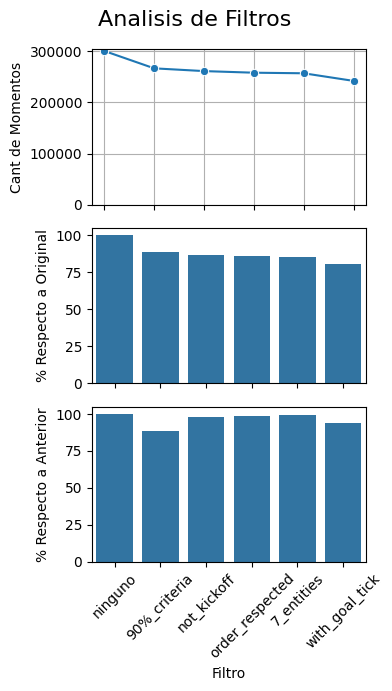

In [58]:
fig, axs = plt.subplots(3, 1, figsize=(4, 7), )

sns.lineplot(data=data_filtros, x='filtro', y='cant_de_momentos', marker='o', ax=axs[0])
#axs[0].set_title('Cant de Momentos por Filtro')
axs[0].set_xlabel('')
axs[0].set_ylabel('Cant de Momentos')
axs[0].grid(True)
axs[0].set_ylim(0,)
axs[0].set_xticklabels([])  # Oculto etiquetas del eje x

sns.barplot(data=data_filtros, x='filtro', y='%_respecto_a_original', ax=axs[1])
#axs[1].set_title('% Respecto a Original por Filtro')
axs[1].set_xlabel('')
axs[1].set_ylabel('% Respecto a Original')
axs[1].set_ylim(0,)
axs[1].grid(False)
axs[1].set_xticklabels([])  # Oculto etiquetas del eje x

sns.barplot(data=data_filtros, x='filtro', y='%_respecto_a_anterior', ax=axs[2])
#axs[2].set_title('% Respecto a Anterior por Filtro')
axs[2].set_xlabel('Filtro')
axs[2].set_ylabel('% Respecto a Anterior')
axs[2].set_ylim(0,)
axs[2].grid(False)
axs[2].tick_params(axis='x', rotation=45)  # Roto etiquetas del eje x

fig.suptitle('Analisis de Filtros', fontsize=16) # Titulo principal

plt.tight_layout()

plt.show()

#### Migro los datos filtrados

In [59]:
# Migro datos de posiciones (ya filtrado)
ruta_archivo = os.path.join('./filtered_data', 'data_posiciones_filtered.csv')
data_posiciones_filtered.to_csv(ruta_archivo, index=False)

In [60]:
# ids de partidos que pasaron el filtrado
ids_filtered = data_posiciones_filtered['match_id'].unique()
ids_filtered

array([ 42,  43,  44,  45,  46,  47,  48,  50,  51,  52,  53,  54,  55,
        56,  57,  58,  59,  60,  61,  66,  67,  68,  69,  70,  71,  72,
        73,  75,  76,  77,  78,  79,  80,  88,  89,  90,  92,  93,  95,
        96,  97,  98,  99, 100, 101, 102, 103, 104, 109, 110, 111, 115,
       116, 117, 119, 121, 122, 123, 124, 126, 127, 128, 129, 130, 132,
       134, 135, 136, 137, 138, 140, 141, 142, 144, 145, 146, 165, 168,
       169, 170, 171, 192, 193, 195, 196, 197, 198, 199, 200, 201, 203,
       204, 205, 206, 207, 208, 209, 210, 211, 212, 214, 218, 220, 221,
       222, 223, 224, 237, 239, 240, 241, 242, 243, 244, 245, 246, 247,
       248, 249, 250, 251, 252, 253, 254, 256, 257, 262, 263, 264, 266,
       267, 268, 270, 271, 272, 273, 274, 275, 276, 277, 279, 281, 282,
       284, 285, 286, 287, 288, 289, 290, 291, 292, 294, 295, 301, 302,
       307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 318, 319, 320,
       321, 322, 323, 324, 325, 326, 327, 328, 329, 335, 337, 33

In [61]:
data_goles_filtered = data_goles[data_goles['match_id'].isin(ids_filtered)]
data_goles_filtered.sample(7)

,id,match_id,player_id,player_name,equipo,tick
567,636,241,201,judas,Blue,148.750000
883,952,376,350,Augus,Red,2.883333
111,180,50,44,.,Blue,97.400000
622,691,263,40,,Blue,152.450000
194,263,79,76,buttow,Blue,59.050000
332,401,135,2,tnt,Red,88.700000
297,366,123,122,respect,Blue,93.983333


In [62]:
# Migro datos de posiciones (ya filtrado)
ruta_archivo = os.path.join('./filtered_data', 'data_goles_filtered.csv')
data_goles_filtered.to_csv(ruta_archivo, index=False)

## ...